# MERFISH mouse brain dataset

This notebook is used to tokenize the MERFISH mouse brain dataset and generate dataset statistics for figures in nicheformer. 

## Imports and definitions

In [1]:
import scanpy as sc
import anndata as ad
import pandas as pd
import numpy as np
import math
import numba
from scipy.sparse import issparse
from sklearn.utils import sparsefuncs

import pyarrow.parquet as pq
import pyarrow
from os.path import join
from tqdm import tqdm

In [2]:
modality_dict = {
    'dissociated': 3,
    'spatial': 4,}

specie_dict = {
    'human': 5,
    'Homo sapiens': 5,
    'Mus musculus': 6,
    'mouse': 6,}

technology_dict = {
    "merfish": 7,
    "MERFISH": 7,
    "cosmx": 8,
    "visium": 9,
    "10x 5' v2": 10,
    "10x 3' v3": 11,
    "10x 3' v2": 12,
    "10x 5' v1": 13,
    "10x 3' v1": 14,
    "10x 3' transcription profiling": 15, 
    "10x transcription profiling": 15,
    "10x 5' transcription profiling": 16,
    "CITE-seq": 17, 
    "Smart-seq v4": 18,
}

author_cell_type_dict = {
    'Astro-Epen': 0, 
    'CB GABA': 1, 
    'CB Glut': 2, 
    'CGE GABA': 3, 
    'CNU GABA': 4,
    'CNU-HYa GABA': 5, 
    'CNU-HYa Glut': 6, 
    'HY GABA': 7, 
    'HY Glut': 8,
    'HY Gnrh1 Glut': 9, 
    'HY MM Glut': 10,
    'IT-ET Glut': 11, 
    'Immune': 12, 
    'LQ': 13,
    'LSX GABA': 14, 
    'MB Dopa': 15, 
    'MB GABA': 16, 
    'MB Glut': 17, 
    'MB-HB Sero': 18,
    'MGE GABA': 19, 
    'MH-LH Glut': 20, 
    'MOB-CR Glut': 21, 
    'MOB-DG-IMN': 22, 
    'MY GABA': 23,
    'MY Glut': 24, 
    'NP-CT-L6b Glut': 25, 
    'OEG': 26, 
    'Oligo': 27, 
    'P GABA': 28, 
    'P Glut': 29,
    'Pineal Glut': 30, 
    'TH Glut': 31, 
    'Vascular': 32
}

niche_label_dict = {
    'CBX-MOB-other neuronal': 0, 
    'Immune': 1, 
    'LQ': 2, 
    'Neuroglial': 3,
    'PAL-sAMY-TH-HY-MB-HB neuronal': 4, 
    'Pallium glutamatergic': 5,
    'Subpallium GABAergic': 6, 
    'Vascular': 7
}

region_label_dict = {
    'CB': 0, 
    'CTXsp': 1, 
    'HB': 2, 
    'HIP': 3, 
    'HY': 4, 
    'Isocortex': 5, 
    'LSX': 6, 
    'MB': 7, 
    'OLF': 8,
    'PAL': 9, 
    'RHP': 10, 
    'STRd': 11, 
    'STRv': 12, 
    'TH': 13, 
    'sAMY': 14, 
    'ventricle': 15,
    'white_matter': 16
}

## Paths

In [2]:
BASE_PATH = '/lustre/groups/ml01/projects/2023_nicheformer/data/data_to_tokenize'
DATA_PATH = '/lustre/groups/ml01/projects/2023_nicheformer_data_anna.schaar/spatial/preprocessed/mouse'
OUT_PATH = '/lustre/groups/ml01/projects/2023_nicheformer_data_anna.schaar/tokenized/nicheformer_downstream/merfish_brain'
GENE_MAPPER_PATH = '/lustre/groups/ml01/projects/2023_nicheformer_data_anna.schaar/concat'

## Tokenization functions

In [4]:
def sf_normalize(X):
    X = X.copy()
    counts = np.array(X.sum(axis=1))
    # avoid zero devision error
    counts += counts == 0.
    # normalize to 10000. counts
    scaling_factor = 10000. / counts

    if issparse(X):
        sparsefuncs.inplace_row_scale(X, scaling_factor)
    else:
        np.multiply(X, scaling_factor.reshape((-1, 1)), out=X)

    return X

@numba.jit(nopython=True, nogil=True)
def _sub_tokenize_data(x: np.array, max_seq_len: int = -1, aux_tokens: int = 30):
    scores_final = np.empty((x.shape[0], max_seq_len if max_seq_len > 0 else x.shape[1]))
    for i, cell in enumerate(x):
        nonzero_mask = np.nonzero(cell)[0]    
        sorted_indices = nonzero_mask[np.argsort(-cell[nonzero_mask])][:max_seq_len] 
        sorted_indices = sorted_indices + aux_tokens # we reserve some tokens for padding etc (just in case)
        if max_seq_len:
            scores = np.zeros(max_seq_len, dtype=np.int32)
        else:
            scores = np.zeros_like(cell, dtype=np.int32)
        scores[:len(sorted_indices)] = sorted_indices.astype(np.int32)
        
        scores_final[i, :] = scores
        
    return scores_final


def tokenize_data(x: np.array, median_counts_per_gene: np.array, max_seq_len: int = None):
    """Tokenize the input gene vector to a vector of 32-bit integers."""

    x = np.nan_to_num(x) # is NaN values, fill with 0s
    x = sf_normalize(x)
    median_counts_per_gene += median_counts_per_gene == 0
    out = x / median_counts_per_gene.reshape((1, -1))

    scores_final = _sub_tokenize_data(out, 4096, 30)

    return scores_final.astype('i4')

## Loading model with right gene ordering

In [5]:
model = sc.read_h5ad(
    f"{BASE_PATH}/model.h5ad"
)

## Technology mean

In [6]:
merfish_mean = np.load(
    f"{BASE_PATH}/merfish_mean_script.npy")

In [7]:
merfish_mean = np.nan_to_num(merfish_mean)
rounded_values = np.where((merfish_mean % 1) >= 0.5, np.ceil(merfish_mean), np.floor(merfish_mean))
merfish_mean = np.where(rounded_values == 0, 1, rounded_values)
merfish_mean

array([ 1.,  1.,  1., ..., 15.,  1., 14.])

## Loading MERFISH mouse brain data 

In [3]:
merfish = sc.read_h5ad(f"{DATA_PATH}/mouse_638850_gaps.h5ad")

In [4]:
merfish_figs = merfish.copy()

AnnData object with n_obs × n_vars = 4334174 × 483
    obs: 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'barcodeCount', 'corrected_x', 'corrected_y', 'origin', 'rotation', 'section', 'animal', 'merscope', 'target_atlas_plate', 'codebook', 'min_genes', 'min_total_reads', 'min_vol', 'genes_detected', 'total_reads', 'total_blanks', 'spot_density', 'max_blank_count', 'blanks_detected', 'cell_qc', 'best.cl', 'clean_region_label', 'prob', 'avg.dist', 'avg.path.cor', 'avg.cor', 'cor.zscore', 'cluster_id', 'cluster_label', 'supertype_id_label', 'Level2_id_label', 'Level1_id_label', 'class_id_label', 'cluster_id.AIT16', 'nt_type_label', 'luster_id', 'subclass_id_label', 'He.label', 'He.cor', 'class_label', 'division_label', 'division_id_label', 'subclass_label', 'supertype_label', 'nt_type_combo_label', 'CCF_landmark', 'CCF_bin_x', 'CCF_bin_y', 'CCF_bin_z', 'structures_id', 'CCF_acronym', 'CCF_analysis', 'CCF_broad', 'cell_type', 'in_fov', '_scvi_batch', '_scvi_

In [12]:
pd.value_counts(merfish_figs.obs.author_cell_type)

Astro-Epen        726015
IT-ET Glut        680021
Oligo             614975
Vascular          544734
CNU GABA          291240
CB Glut           216863
NP-CT-L6b Glut    174616
MOB-DG-IMN        145856
CB GABA           145435
MGE GABA           90109
MB Glut            88169
Immune             80008
TH Glut            63808
MB GABA            62468
MY Glut            58610
MY GABA            51932
CGE GABA           45556
HY GABA            43813
CNU-HYa GABA       36874
HY Glut            29795
P Glut             29090
CNU-HYa Glut       26243
P GABA             19883
LSX GABA           18965
MOB-CR Glut        13362
OEG                13147
MH-LH Glut          6503
MB Dopa             5040
HY MM Glut          3943
MB-HB Sero          3557
LQ                  3267
Pineal Glut          199
HY Gnrh1 Glut         78
Name: author_cell_type, dtype: int64

In [87]:
for i, img_key in enumerate(np.unique(merfish_figs.obs.library_key)):
    if img_key in np.unique(merfish_figs[merfish_figs.obs.nicheformer_split=='test'].obs.library_key):
        print(i)

11
26
28
35
43


In [89]:
np.unique(merfish_figs[merfish_figs.obs.nicheformer_split=='test'].obs.library_key)

array(['1199650965', '1199651024', '1199651033', '1199651057',
       '1199651081'], dtype=object)

In [92]:
sc.settings.set_figure_params(dpi=300, facecolor='white')

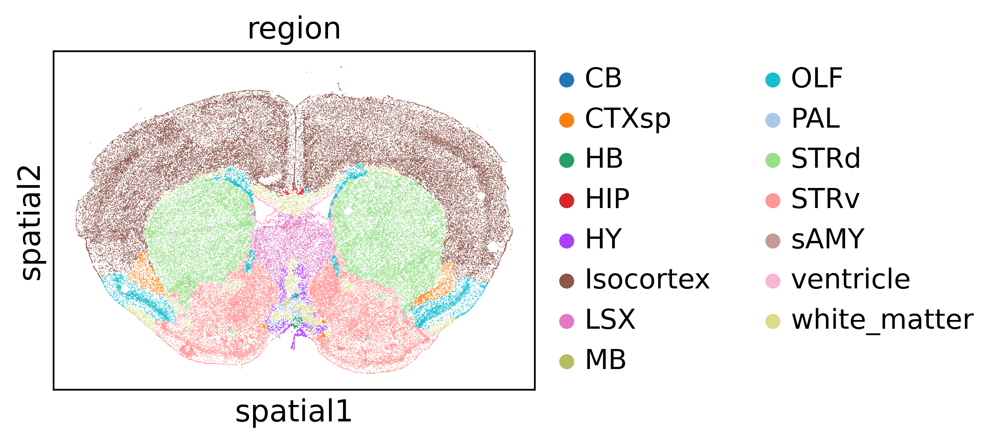

In [98]:
sc.pl.spatial(merfish_figs[merfish_figs.obs.library_key=='1199651081'], color='region', spot_size=15)

In [76]:
np.unique(merfish_figs.obs.region)

array(['CB', 'CTXsp', 'HB', 'HIP', 'HY', 'Isocortex', 'LSX', 'MB', 'OLF',
       'PAL', 'RHP', 'STRd', 'STRv', 'TH', 'sAMY', 'ventricle',
       'white_matter'], dtype=object)

/home/icb/anna.schaar/miniconda3/envs/nf-data/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


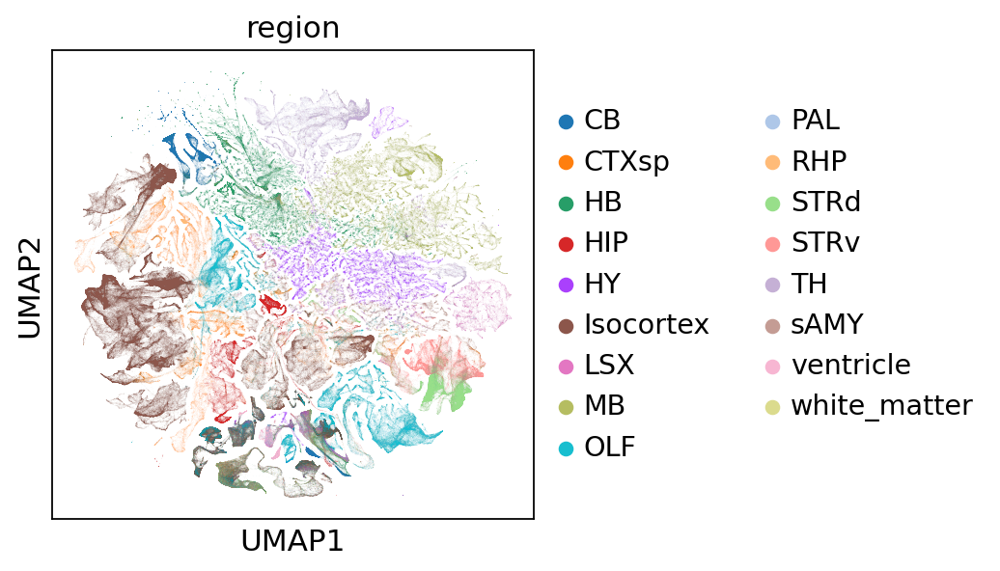

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d']

In [91]:
merfish_figs.obsm['X_umap'] = merfish_figs.obsm['UMAP2']
sc.pl.umap(merfish_figs, color='region')
merfish_figs.uns['region_colors']

In [9]:
np.unique(merfish_figs.obs.library_key)

array(['1199650929', '1199650932', '1199650935', '1199650938',
       '1199650941', '1199650944', '1199650950', '1199650953',
       '1199650956', '1199650959', '1199650962', '1199650965',
       '1199650968', '1199650972', '1199650975', '1199650978',
       '1199650981', '1199650984', '1199650999', '1199651002',
       '1199651005', '1199651009', '1199651012', '1199651015',
       '1199651018', '1199651021', '1199651024', '1199651027',
       '1199651033', '1199651036', '1199651039', '1199651042',
       '1199651045', '1199651048', '1199651054', '1199651057',
       '1199651060', '1199651063', '1199651066', '1199651069',
       '1199651072', '1199651075', '1199651078', '1199651081',
       '1199651084', '1199651091', '1199651094', '1199651097',
       '1199651100', '1199651103', '1199651106', '1199651109',
       '1199651112', '1199651115', '1199651121', '1199651127',
       '1199651130', '1199651133', '1199651136'], dtype=object)

In [78]:
df_list = []
for img_key in np.unique(merfish_figs.obs.library_key):
    df = pd.DataFrame(pd.value_counts(merfish_figs[merfish_figs.obs.library_key==img_key].obs.region)).T
    df.index = [img_key]
    df_list.append(df)

In [70]:
df

,CBX-MOB-other neuronal,Neuroglial,Vascular,Immune,Subpallium GABAergic,LQ
1199651136,11568,2156,1000,124,29,1


In [79]:
data_df=pd.concat(df_list, axis=0)

In [80]:
data_df = data_df.fillna(0)

In [81]:
data_df = data_df[['CB', 'CTXsp', 'HB', 'HIP', 'HY', 'Isocortex', 'LSX', 'MB', 'OLF',
       'PAL', 'RHP', 'STRd', 'STRv', 'TH', 'sAMY', 'ventricle',
       'white_matter']]

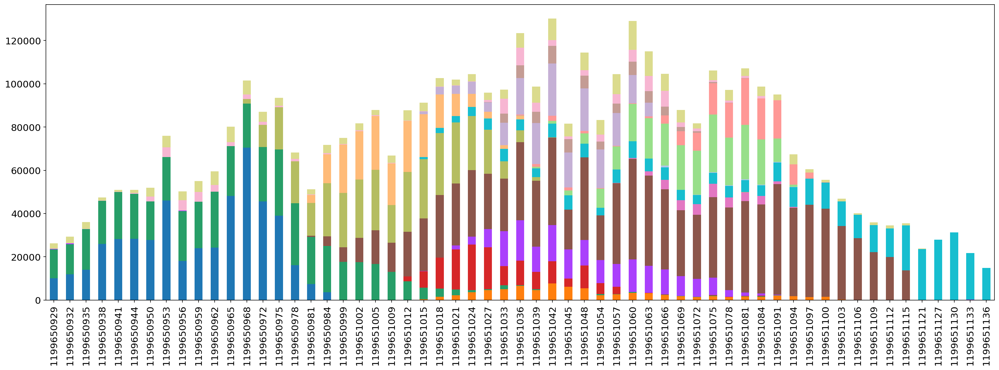

In [82]:
fig, ax = plt.subplots(1, 1, figsize=(25,8))
data_df.plot(kind='bar', color=merfish_figs.uns['region_colors'], stacked=True, ax=ax)
ax.grid(False)#
ax.get_legend().remove()

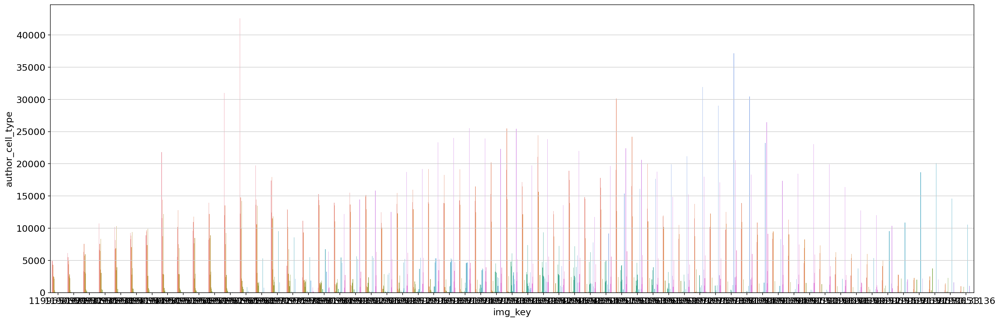

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(25,8))
sns.barplot(data=data_df, x='img_key', y='author_cell_type', hue='index', ax=ax)
ax.get_legend().remove()

In [6]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

1
2
3
4


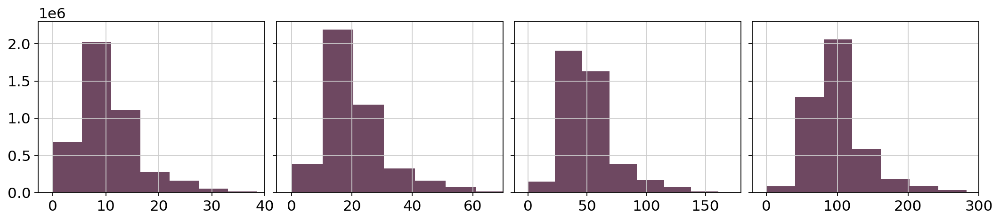

In [17]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 4, figsize=(16,3), sharey=True)
fig.subplots_adjust(wspace=0.05)
limits = {
    #0: 8,
    1: 40,
    2: 70,
    3: 180,
    4: 300
}
for idx in np.arange(5)[1:]:
    print(idx)
    ax[idx-1].hist(
        x=np.array(merfish_figs.obsm[f"X_niche_{idx}"].sum(axis=1)),
        color='#6e4861', bins=10
    )
    #ax[idx-1].grid(False)
    ax[idx-1].set_ylim(top=2300000)
    ax[idx-1].set_xlim(right=limits[idx])

In [15]:
adatas = []
for cell_type in np.unique(merfish.obs.niche):
    adatas.append(
        sc.pp.subsample(
            merfish[merfish.obs['niche'] == cell_type], fraction=0.1, copy=True
        )
    )

In [21]:
merfish_figs.obsm['spatial'] = merfish_figs.obsm['spatial_rotated']

In [29]:
merfish_figs.obsm['X_umap'] = merfish_figs.obsm['UMAP2']

/home/icb/anna.schaar/miniconda3/envs/nf-data/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


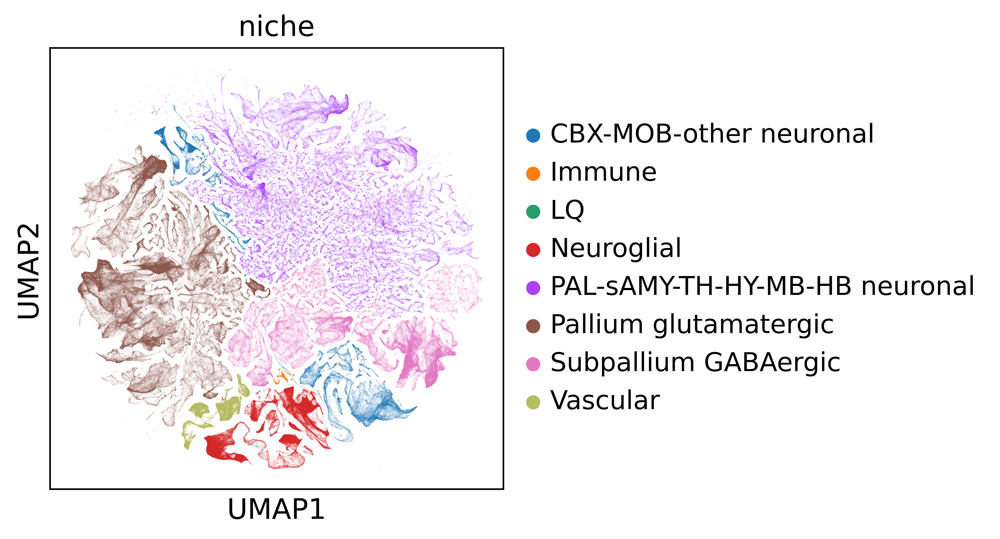

In [30]:
sc.pl.umap(merfish_figs, color='niche')

In [25]:
sc.settings.set_figure_params(dpi=500, facecolor='white')

In [32]:
merfish_figs.uns['niche_colors']

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61']

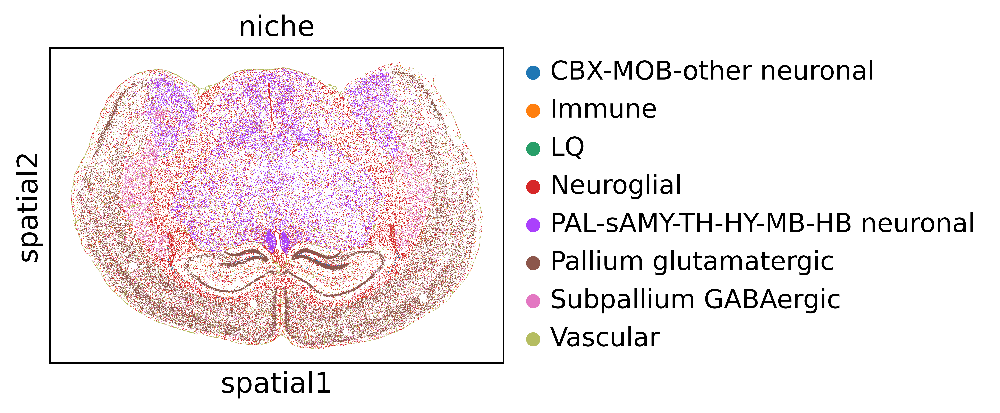

In [31]:
sc.pl.spatial(merfish_figs[merfish_figs.obs.library_key == '1199651048'], spot_size=15, color='niche')

In [19]:
np.unique(merfish_figs.obs.library_key)

array(['1199650929', '1199650932', '1199650935', '1199650938',
       '1199650941', '1199650944', '1199650950', '1199650953',
       '1199650956', '1199650959', '1199650962', '1199650965',
       '1199650968', '1199650972', '1199650975', '1199650978',
       '1199650981', '1199650984', '1199650999', '1199651002',
       '1199651005', '1199651009', '1199651012', '1199651015',
       '1199651018', '1199651021', '1199651024', '1199651027',
       '1199651033', '1199651036', '1199651039', '1199651042',
       '1199651045', '1199651048', '1199651054', '1199651057',
       '1199651060', '1199651063', '1199651066', '1199651069',
       '1199651072', '1199651075', '1199651078', '1199651081',
       '1199651084', '1199651091', '1199651094', '1199651097',
       '1199651100', '1199651103', '1199651106', '1199651109',
       '1199651112', '1199651115', '1199651121', '1199651127',
       '1199651130', '1199651133', '1199651136'], dtype=object)

In [16]:
merfish_subsample = ad.concat(adatas)


In [11]:
merfish_subsample = merfish_figs[merfish_figs.obs.nicheformer_split == 'test']

In [12]:
merfish_subsample.obsm['X_umap'] = merfish_subsample.obsm['UMAP2']

/tmp/ipykernel_3687300/2805800763.py:1: ImplicitModificationWarning: Setting element `.obsm['X_umap']` of view, initializing view as actual.
  merfish_subsample.obsm['X_umap'] = merfish_subsample.obsm['UMAP2']


In [19]:
color_map = {
    'Isocortex':'#2d344a',
    'OLF':'#43405b',
    'CTXsp':'#594c6b',
    'HIP':'#837693',
    'RHP':'#aca0bb',
    
    'STRd':'#caf0f8',
    'STRv':'#80aabf',
    'PAL':'#639aeb',
    'LSX':'#0156b7',

    #pink
    'TH':'#cd2893',
    'HY':'#f7a6e3',

    'HB':'#c8cf83',
    'CB':'#8f8f63',

    'MB':'#c64242',

    'sAMY':'#d38ff0',

    'ventricle':'#001b29',

    'white_matter':'#e8deB8',
}

In [169]:
merfish_subsample.uns['region_colors'] = [
    # cerebral cortex
    # Isocortex, OLF, CTXsp, HIP, RHP (retrohippocampal region)

    # subpallium
    # STRd (dorsal), STRv (ventral), PAL, LSX (lateral septal complex)

    # Diencephalon
    # TH, HY

    # Hindbrain
    # CB, HB

    # midbrain
    # MB

    # striatum-like amygdalar nuclei 
    # sAMY

    # ventricel

    # white matter
    
    
    '#b09bed',
    '#366485',
    '#80AABF',
    
    '#080061',
    '#445590',

    '#cd2893',
    '#f7a6e3',
    # tumor
    '#594c6b',
    '#001b29'
]

In [20]:
merfish_subsample.uns['region_colors'] = [color_map[x] for x in np.unique(merfish_subsample.obs.region)]

/home/icb/anna.schaar/miniconda3/envs/nf-data/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


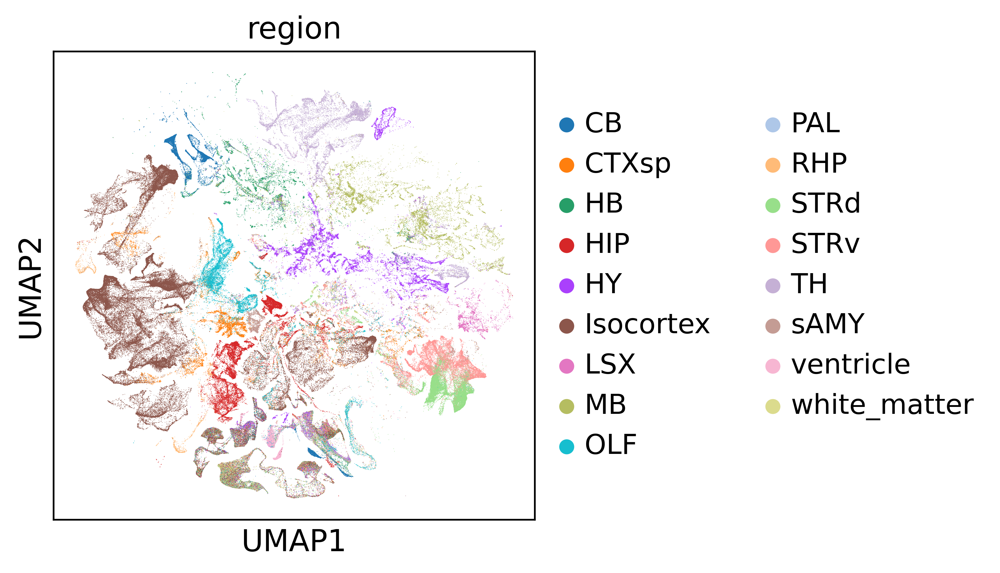

In [14]:
sc.settings.set_figure_params(dpi=300, facecolor='white')
sc.pl.umap(merfish_subsample, color='region')

In [34]:
merfish_subsample.obs.columns

Index(['volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y',
       'corrected_x', 'corrected_y', 'section', 'origin', 'rotation',
       'n_genes_by_counts', 'total_counts', 'total_counts_Blank',
       'pct_counts_Blank', 'total_counts_per_cell_volume',
       'total_counts_Blank_per_cell_volume', 'n_genes', 'blank_qc', 'doublets',
       'Solo_prediction', 'class_label', 'class_name',
       'class_bootstrapping_probability', 'class_avg_correlation',
       'subclass_label', 'subclass_name', 'subclass_bootstrapping_probability',
       'subclass_avg_correlation', 'supertype_label', 'supertype_name',
       'supertype_bootstrapping_probability', 'supertype_avg_correlation',
       'cluster_label', 'cluster_name', 'cluster_alias',
       'cluster_bootstrapping_probability', 'cluster_avg_correlation',
       'class_color', 'subclass_color', 'supertype_color', 'cluster_color',
       'min_corrected_x', 'min_corrected_y', 'spatial_x', 'spatial_y',
       'offset_x', 'offs

### Gene id mapping
The MERFISH brain data is mouse data which we first need to map to orthologous genes for using it in nicheformer. We use the same mapping function as used for datasets in the pertaining. Gene ids must be human stable gene ids.

In [9]:
gene_mapper = pd.read_csv(
    f"{GENE_MAPPER_PATH}/mart_export.txt", sep=','
).drop_duplicates('Gene stable ID').set_index('Gene stable ID')
gene_mapper.head()

,Gene name,Source of gene name,Human gene stable ID,Human gene name,"Human orthology confidence [0 low, 1 high]"
Gene stable ID,,,,,
ENSMUSG00000064341,mt-Nd1,MGI Symbol,ENSG00000198888,MT-ND1,1
ENSMUSG00000064345,mt-Nd2,MGI Symbol,ENSG00000198763,MT-ND2,1
ENSMUSG00000064351,mt-Co1,MGI Symbol,ENSG00000198804,MT-CO1,1
ENSMUSG00000064354,mt-Co2,MGI Symbol,ENSG00000198712,MT-CO2,1
ENSMUSG00000064356,mt-Atp8,MGI Symbol,ENSG00000228253,MT-ATP8,0


In [10]:
merfish.var = merfish.var.join(gene_mapper, how='left')
merfish.var['orthologous_gene_id'] = [
    list(
        merfish.var.index
    )[i] if str(x)=='nan' else x for i, x in enumerate(merfish.var['Human gene stable ID'])
]
merfish.var = merfish.var.reset_index().set_index('orthologous_gene_id')

In [11]:
merfish.var 

,index,Input,feature_types,feature_name,Gene name,Source of gene name,Human gene stable ID,Human gene name,"Human orthology confidence [0 low, 1 high]"
orthologous_gene_id,,,,,,,,,
ENSG00000065675,ENSMUSG00000026778,Prkcq,protein coding gene,Prkcq,Prkcq,MGI Symbol,ENSG00000065675,PRKCQ,1.0
ENSG00000130635,ENSMUSG00000026837,Col5a1,protein coding gene,Col5a1,Col5a1,MGI Symbol,ENSG00000130635,COL5A1,1.0
ENSG00000163873,ENSMUSG00000001985,Grik3,protein coding gene,Grik3,Grik3,MGI Symbol,ENSG00000163873,GRIK3,1.0
ENSG00000115457,ENSMUSG00000039323,Igfbp2,protein coding gene,Igfbp2,Igfbp2,MGI Symbol,ENSG00000115457,IGFBP2,1.0
ENSG00000143867,ENSMUSG00000048387,Osr1,protein coding gene,Osr1,Osr1,MGI Symbol,ENSG00000143867,OSR1,1.0
...,...,...,...,...,...,...,...,...,...
ENSG00000119547,ENSMUSG00000045991,Onecut2,protein coding gene,Onecut2,Onecut2,MGI Symbol,ENSG00000119547,ONECUT2,1.0
ENSG00000007062,ENSMUSG00000029086,Prom1,protein coding gene,Prom1,Prom1,MGI Symbol,ENSG00000007062,PROM1,1.0
ENSG00000180176,ENSMUSG00000000214,Th,protein coding gene,Th,Th,MGI Symbol,ENSG00000180176,TH,1.0


## Concatenation
Next we concatenate the `model` and the `merfish` object to ensure they are in the same order. This ensures we have the same gene ordering in the object.

In [12]:
adata = ad.concat([model, merfish], join='outer', axis=0)
# dropping the first observation 
merfish = adata[1:].copy()
# for memory efficiency 
del adata

In [13]:
merfish.obs = merfish.obs[
    ['assay', 'organism', 'nicheformer_split', 'batch', 'niche', 'region', 'author_cell_type']
]
merfish.obs['modality'] = 'spatial'
merfish.obs['specie'] = merfish.obs.organism

In [14]:
merfish.obs.replace({'specie': specie_dict}, inplace=True)
merfish.obs.replace({'modality': modality_dict}, inplace=True)
merfish.obs.replace({'assay': technology_dict}, inplace=True)
merfish.obs.replace({'author_cell_type': author_cell_type_dict}, inplace=True)
merfish.obs.replace({'niche': niche_label_dict}, inplace=True)
merfish.obs.replace({'region': region_label_dict}, inplace=True)

## Tokenize MERFISH train data

We know tokenize the train partition of the dataset. 

In [15]:
SPLIT = 'train'

In [16]:
# subsetting the anndata object
merfish_split = merfish[merfish.obs.nicheformer_split == SPLIT].copy()
# dropping the index as the original index can create issues 
merfish_split.obs.reset_index(drop=True, inplace=True)
# writing the data
merfish_split.write(f"{OUT_PATH}/merfish_mouse_brain_{SPLIT}_ready_to_tokenize.h5ad")

In [17]:
obs_merfish_split = merfish_split.obs
print('n_obs: ', obs_merfish_split.shape[0])
N_BATCHES = math.ceil(obs_merfish_split.shape[0] / 10_000)
print('N_BATCHES: ', N_BATCHES)
batch_merfish_indices = np.array_split(obs_merfish_split.index, N_BATCHES)
chunk_len = len(batch_merfish_indices[0])
print('chunk_len: ', chunk_len)

n_obs:  3840713
N_BATCHES:  385
chunk_len:  9976


In [18]:
obs_merfish_split = obs_merfish_split.reset_index().rename(columns={'index':'idx'})
obs_merfish_split['idx'] = obs_merfish_split['idx'].astype('i8')

In [21]:
print(f"Tokenizing {SPLIT}")
for batch in tqdm(range(N_BATCHES)):
    obs_tokens = obs_merfish_split.iloc[batch*chunk_len:chunk_len*(batch+1)].copy()
    merfish_tokenized = tokenize_data(merfish_split.X[batch*chunk_len:chunk_len*(batch+1)], merfish_mean, 4096)

    obs_tokens = obs_tokens[['assay', 'specie', 'modality', 'idx', 'author_cell_type', 'niche', 'region']]
    # concatenate dataframes
    
    obs_tokens['X'] = [merfish_tokenized[i, :] for i in range(merfish_tokenized.shape[0])]
    
    for i in np.arange(5):
        niche = merfish_split.obsm[f"X_niche_{i}"].toarray()[batch*chunk_len:chunk_len*(batch+1)]
        obs_tokens[f"X_niche_{i}"] = [niche[i, :] for i in range(niche.shape[0])]

    # mix spatial and dissociate data
    obs_tokens = obs_tokens.sample(frac=1)
    
    total_table = pyarrow.Table.from_pandas(obs_tokens)
    
    pq.write_table(total_table, f'{join(OUT_PATH, SPLIT)}/tokens-{batch}.parquet',
                    row_group_size=1024,)

Tokenizing train


100%|█████████████████████████████████████████| 385/385 [25:01<00:00,  3.90s/it]


In [20]:
# checking for the last object whether everything looks accurate 
obs_tokens.head(2)

,assay,specie,modality,idx,author_cell_type,niche,region,X,X_niche_0,X_niche_1,X_niche_2,X_niche_3,X_niche_4
571073,7,6,4,571073,2,0,0,"[6768, 574, 2738, 13961, 4797, 13005, 3258, 14...","[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[3.0, 0.0, 20.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[5.0, 4.0, 35.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[10.0, 11.0, 78.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[17.0, 29.0, 137.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0..."
575106,7,6,4,575106,2,0,0,"[12434, 6768, 10469, 2738, 12262, 4894, 7451, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 22.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 40.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 101.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[12.0, 10.0, 178.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0..."


In [22]:
pd.read_parquet( f'{join(OUT_PATH, SPLIT)}/tokens-{batch}.parquet').head(2)

,assay,specie,modality,idx,author_cell_type,niche,region,X,X_niche_0,X_niche_1,X_niche_2,X_niche_3,X_niche_4
3838974,7,6,4,3838974,32,7,8,"[18820, 12290, 5543, 1332, 13944, 13285, 20224...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[7.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3836549,7,6,4,3836549,0,3,8,"[5610, 8662, 10469, 20245, 1332, 11253, 8816, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[5.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[8.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [23]:
OUT_PATH

'/lustre/groups/ml01/projects/2023_nicheformer_data_anna.schaar/tokenized/nicheformer_downstream/merfish_brain'

### Reading for testing
We are reading one parquet file to test whether everything worked.

## Tokenize MERFISH test data

In [24]:
SPLIT = 'test'

In [25]:
merfish_split = merfish[merfish.obs.nicheformer_split == SPLIT].copy()
merfish_split.obs.reset_index(drop=True, inplace=True)
merfish_split.write(f"{OUT_PATH}/merfish_mouse_brain_{SPLIT}_ready_to_tokenize.h5ad")

In [27]:
obs_merfish_split = merfish_split.obs
print('n_obs: ', obs_merfish_split.shape[0])

N_BATCHES = math.ceil(obs_merfish_split.shape[0] / 10_000)
print('N_BATCHES: ', N_BATCHES)
batch_merfish_indices = np.array_split(obs_merfish_split.index, N_BATCHES)
chunk_len = len(batch_merfish_indices[0])
print('chunk_len: ', chunk_len)

n_obs:  493461
N_BATCHES:  50
chunk_len:  9870


In [28]:
obs_merfish_split = obs_merfish_split.reset_index().rename(columns={'index':'idx'})
obs_merfish_split['idx'] = obs_merfish_split['idx'].astype('i8')

In [29]:
print(f"Tokenizing {SPLIT}")
for batch in tqdm(range(N_BATCHES)):
    obs_tokens = obs_merfish_split.iloc[batch*chunk_len:chunk_len*(batch+1)].copy()
    merfish_tokenized = tokenize_data(merfish_split.X[batch*chunk_len:chunk_len*(batch+1)], merfish_mean, 4096)

    obs_tokens = obs_tokens[['assay', 'specie', 'modality', 'idx', 'author_cell_type', 'niche', 'region']]
    # concatenate dataframes
    
    obs_tokens['X'] = [merfish_tokenized[i, :] for i in range(merfish_tokenized.shape[0])]
    
    for i in np.arange(5):
        niche = merfish_split.obsm[f"X_niche_{i}"].toarray()[batch*chunk_len:chunk_len*(batch+1)]
        obs_tokens[f"X_niche_{i}"] = [niche[i, :] for i in range(niche.shape[0])]

    # mix spatial and dissociate data
    obs_tokens = obs_tokens.sample(frac=1)
    
    total_table = pyarrow.Table.from_pandas(obs_tokens)
    
    pq.write_table(total_table, f'{join(OUT_PATH, SPLIT)}/tokens-{batch}.parquet',
                    row_group_size=1024,)

Tokenizing test


100%|███████████████████████████████████████████| 50/50 [01:35<00:00,  1.91s/it]


In [125]:
# checking for the last object whether everything looks accurate 
obs_tokens.head(2)

,assay,specie,modality,idx,author_cell_type,niche,region,X,X_niche_0,X_niche_1,X_niche_2,X_niche_3,X_niche_4
426722,7,6,4,426722,01 IT-ET Glut,nan,nan,"[6768, 3258, 9496, 2738, 14900, 13961, 16091, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[13.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[25.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[58.0, 0.0, 0.0, 0.0, 0.0, 2.0, 1.0, 0.0, 0.0,...","[105.0, 0.0, 0.0, 0.0, 0.0, 4.0, 1.0, 0.0, 0.0..."
427496,7,6,4,427496,01 IT-ET Glut,nan,nan,"[6343, 677, 1088, 13386, 6027, 9340, 11885, 33...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[3.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[8.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...","[20.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0,...","[33.0, 0.0, 0.0, 0.0, 0.0, 5.0, 2.0, 0.0, 0.0,..."


In [126]:
pd.read_parquet( f'{join(OUT_PATH, SPLIT)}/tokens-{batch}.parquet').head(2)

,assay,specie,modality,idx,author_cell_type,niche,region,X,X_niche_0,X_niche_1,X_niche_2,X_niche_3,X_niche_4
426722,7,6,4,426722,01 IT-ET Glut,nan,nan,"[6768, 3258, 9496, 2738, 14900, 13961, 16091, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[13.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[25.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[58.0, 0.0, 0.0, 0.0, 0.0, 2.0, 1.0, 0.0, 0.0,...","[105.0, 0.0, 0.0, 0.0, 0.0, 4.0, 1.0, 0.0, 0.0..."
427496,7,6,4,427496,01 IT-ET Glut,nan,nan,"[6343, 677, 1088, 13386, 6027, 9340, 11885, 33...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[3.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[8.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...","[20.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0,...","[33.0, 0.0, 0.0, 0.0, 0.0, 5.0, 2.0, 0.0, 0.0,..."
